In [3]:
# !pip install patchworklib
# !pip install plotnine
# !pip install leidenalg

data downloaded from https://zenodo.org/records/7813151

In [4]:
from starfysh import (AA, utils, plot_utils, post_analysis)
from starfysh import starfysh as sf_model

import os
import numpy as np
import pandas as pd
import torch



import matplotlib.pyplot as plt
import matplotlib.font_manager
from matplotlib import rcParams

import seaborn as sns
sns.set_style('white')

font_list = []
fpaths = matplotlib.font_manager.findSystemFonts()
for i in fpaths:
    try:
        f = matplotlib.font_manager.get_font(i)
        font_list.append(f.family_name)
    except RuntimeError:
        pass

font_list = set(font_list)
plot_font = 'Helvetica' if 'Helvetica' in font_list else 'FreeSans'

rcParams['font.family'] = plot_font
rcParams.update({'font.size': 10})
rcParams.update({'figure.dpi': 300})
rcParams.update({'figure.figsize': (3,3)})
rcParams.update({'savefig.dpi': 500})

import warnings
warnings.filterwarnings('ignore')

[2023-11-06 10:22:19] Note: NumExpr detected 16 cores but "NUMEXPR_MAX_THREADS" not set, so enforcing safe limit of 8.
[2023-11-06 10:22:19] NumExpr defaulting to 8 threads.
/home/user/anaconda3/lib/python3.9/site-packages/umap/distances.py:1063: NumbaDeprecationWarning: The 'nopython' keyword argument was not supplied to the 'numba.jit' decorator. The implicit default value for this argument is currently False, but it will be changed to True in Numba 0.59.0. See https://numba.readthedocs.io/en/stable/reference/deprecation.html#deprecation-of-object-mode-fall-back-behaviour-when-using-jit for details.
  @numba.jit()
/home/user/anaconda3/lib/python3.9/site-packages/umap/distances.py:1071: NumbaDeprecationWarning: The 'nopython' keyword argument was not supplied to the 'numba.jit' decorator. The implicit default value for this argument is currently False, but it will be changed to True in Numba 0.59.0. See https://numba.readthedocs.io/en/stable/reference/deprecation.html#deprecation-of-o

TypeError: Descriptors cannot not be created directly.
If this call came from a _pb2.py file, your generated code is out of date and must be regenerated with protoc >= 3.19.0.
If you cannot immediately regenerate your protos, some other possible workarounds are:
 1. Downgrade the protobuf package to 3.20.x or lower.
 2. Set PROTOCOL_BUFFERS_PYTHON_IMPLEMENTATION=python (but this will use pure-Python parsing and will be much slower).

More information: https://developers.google.com/protocol-buffers/docs/news/2022-05-06#python-updates

In [30]:
data_path = 'GSM6176208_p1/'
sample_id = 'GSM6176208_p1'
sig_name = 'PCNSL_clusters.csv'

In [31]:
adata, adata_normed = utils.load_adata(data_folder=data_path,
                                       sample_id=sample_id, # sample id
                                       n_genes=2000  # number of highly variable genes to keep
                                       )

[2023-10-12 15:47:18] Preprocessing1: delete the mt and rp
[2023-10-12 15:47:19] Preprocessing2: Normalize
[2023-10-12 15:47:19] Preprocessing3: Logarithm
[2023-10-12 15:47:19] Preprocessing4: Find the variable genes


In [32]:
gene_sig = pd.read_csv(os.path.join(data_path, sig_name))
gene_sig = utils.filter_gene_sig(gene_sig, adata.to_df())
gene_sig.head()

,CS1,CS2,CS3,CS4
0,IGHV3-64D,RNU6-329P,IGKV1-17,ACOD1
1,PPP1R2C,OR10T1P,YRDCP1,TRAV12-2
2,RFPL4AP1,RNU6-535P,IGHV3-73,CXCR2P1
3,IGLV7-43,RN7SL843P,TRBV12-5,TRAJ22
4,HOXD11,MED14P1,LINC01228,KLRC1


In [33]:
adata

AnnData object with n_obs × n_vars = 1083 × 16704
    obs: 'in_tissue', 'array_row', 'array_col', 'sample', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_50_genes', 'pct_counts_in_top_100_genes', 'pct_counts_in_top_200_genes', 'pct_counts_in_top_500_genes', 'total_counts_mt', 'log1p_total_counts_mt', 'pct_counts_mt'
    var: 'gene_ids', 'feature_types', 'genome', 'highly_variable'
    uns: 'spatial'
    obsm: 'spatial'

... storing 'sample' as categorical
... storing 'feature_types' as categorical
... storing 'genome' as categorical


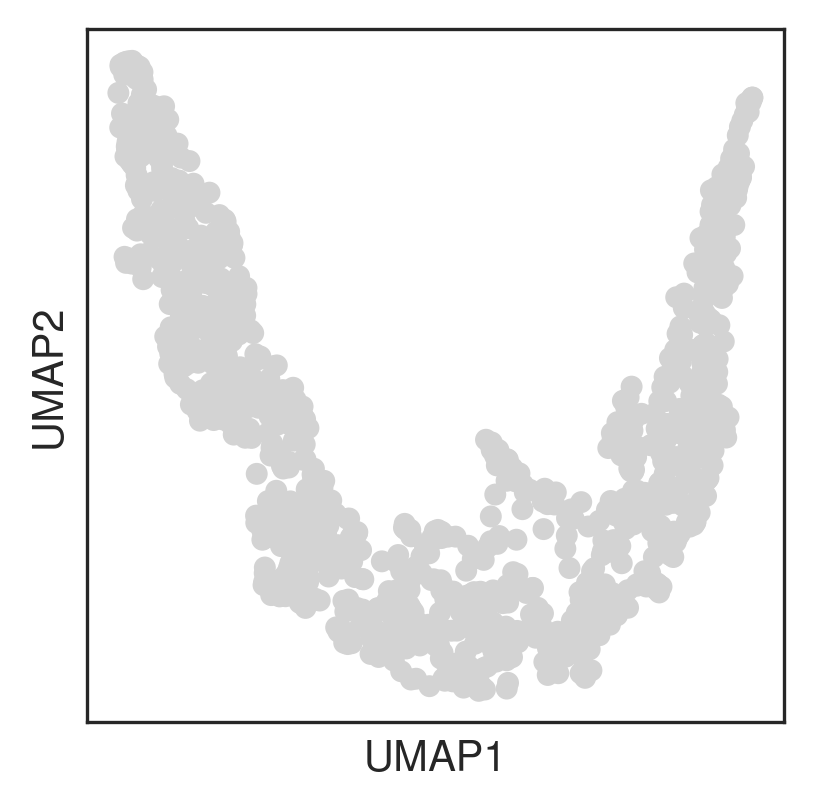

In [34]:
img_metadata = utils.preprocess_img(data_path,
                                    sample_id,
                                    adata_index=adata.obs.index,
                                    hchannel=False
                                    )
img, map_info, scalefactor = img_metadata['img'], img_metadata['map_info'], img_metadata['scalefactor']
umap_df = utils.get_umap(adata, display=True)

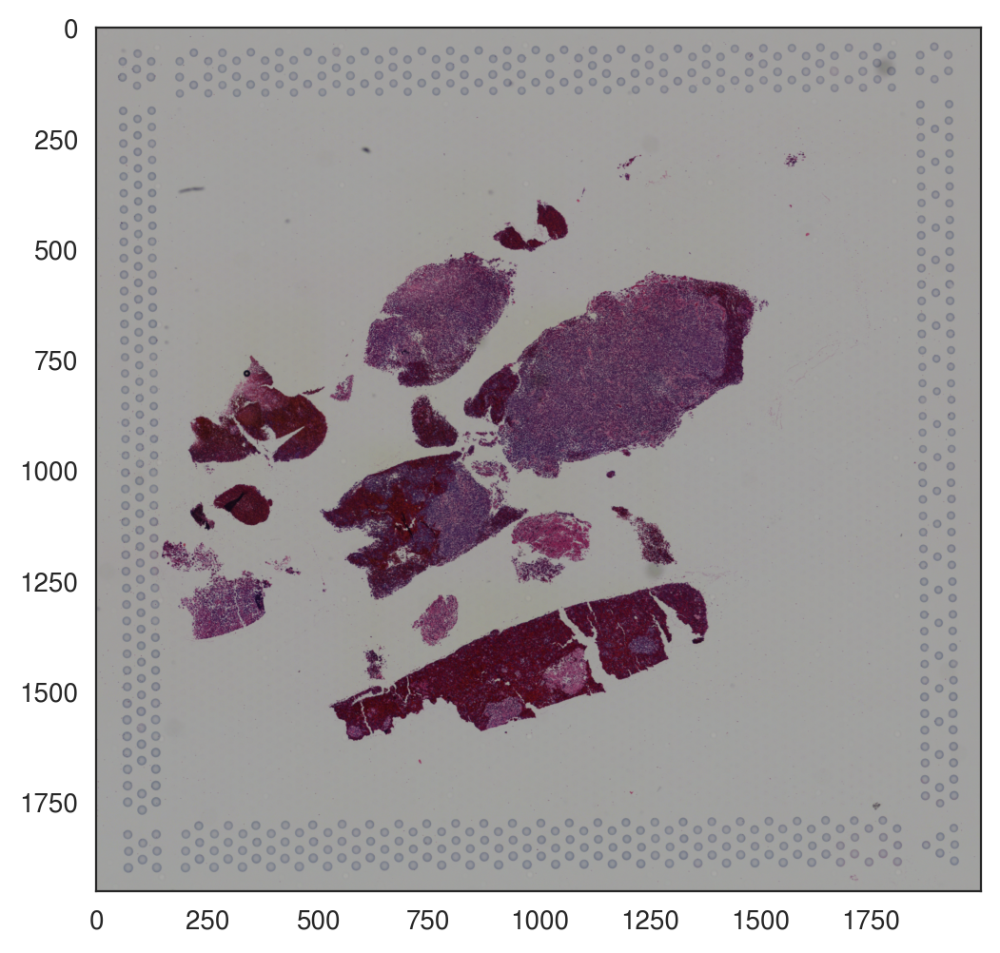

In [35]:
plt.figure(figsize=(6, 6), dpi=200)
plt.imshow(img)
plt.savefig("figures/fig_HE_visium_1.pdf",dpi=300,bbox_inches="tight")
plt.show()

In [8]:
map_info.head()

,array_row,array_col,imagerow,imagecol,sample
AAACCGGGTAGGTACC-1,42,28,3765,2882,GSM6176208_p1
AAACCTCATGAAGTTG-1,37,19,4065,2596,GSM6176208_p1
AAACGAAGAACATACC-1,6,64,2589,800,GSM6176208_p1
AAACGAGACGGTTGAT-1,35,79,2080,2466,GSM6176208_p1
AAACTGCTGGCTCCAA-1,45,67,2473,3044,GSM6176208_p1


In [9]:
# Parameters for training
visium_args = utils.VisiumArguments(adata,
                                    adata_normed,
                                    gene_sig,
                                    img_metadata,
                                    sample_id=sample_id
                                   )

adata, adata_normed = visium_args.get_adata()
anchors_df = visium_args.get_anchors()

[2023-10-12 15:20:19] Subsetting highly variable & signature genes ...
[2023-10-12 15:20:24] Smoothing library size by taking averaging with neighbor spots...
[2023-10-12 15:20:25] Retrieving & normalizing signature gene expressions...
[2023-10-12 15:20:25] Identifying anchor spots (highly expression of specific cell-type signatures)...


In [10]:
adata.shape

(1083, 2000)

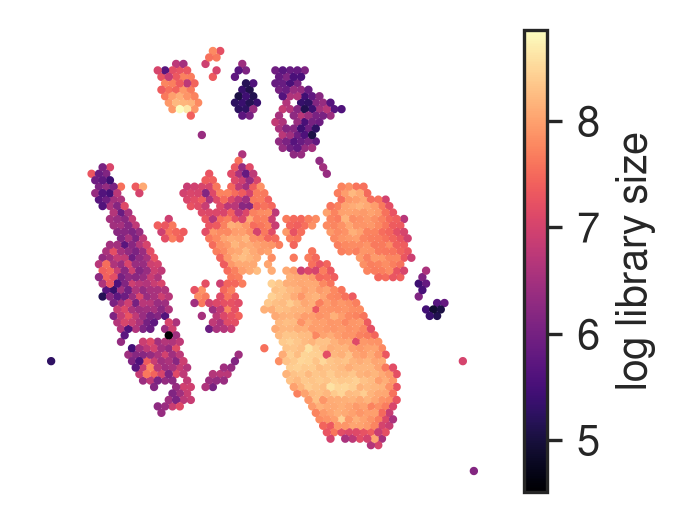

In [11]:
plot_utils.plot_spatial_feature(adata,
                                map_info,
                                visium_args.log_lib,
                                label='log library size'
                               )

In [12]:
n_repeats = 3
epochs = 200
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')


In [13]:
model, loss = utils.run_starfysh(visium_args,
                                 n_repeats=n_repeats,
                                 epochs=epochs,
                                 # poe=True,
                                 device=device)

[2023-10-12 15:20:37] Running Starfysh with 3 restarts, choose the model with best parameters...
[2023-10-12 15:20:37]  ===  Restart Starfysh 1 === 

[2023-10-12 15:20:39] Initializing model parameters...
[2023-10-12 15:20:48] Epoch[10/200], train_loss: 1386.7321, train_reconst: 1297.4483, train_u: 4.2267,train_z: 17.9476,train_c: 68.9330,train_n: 2.4033
[2023-10-12 15:20:55] Epoch[20/200], train_loss: 1301.9659, train_reconst: 1245.3396, train_u: 4.4529,train_z: 18.1600,train_c: 35.6051,train_n: 2.8612
[2023-10-12 15:21:02] Epoch[30/200], train_loss: 1273.8093, train_reconst: 1214.5922, train_u: 4.8904,train_z: 17.6741,train_c: 38.5242,train_n: 3.0187
[2023-10-12 15:21:10] Epoch[40/200], train_loss: 1224.1924, train_reconst: 1177.6420, train_u: 5.4069,train_z: 16.9815,train_c: 26.3977,train_n: 3.1712
[2023-10-12 15:21:17] Epoch[50/200], train_loss: 1219.7398, train_reconst: 1180.3436, train_u: 5.9455,train_z: 16.9612,train_c: 19.2443,train_n: 3.1906
[2023-10-12 15:21:25] Epoch[60/200]

In [14]:
adata, adata_normed = visium_args.get_adata()
inference_outputs, generative_outputs = sf_model.model_eval(model,
                                                            adata,
                                                            visium_args,
                                                            # poe=True,
                                                            device=device)

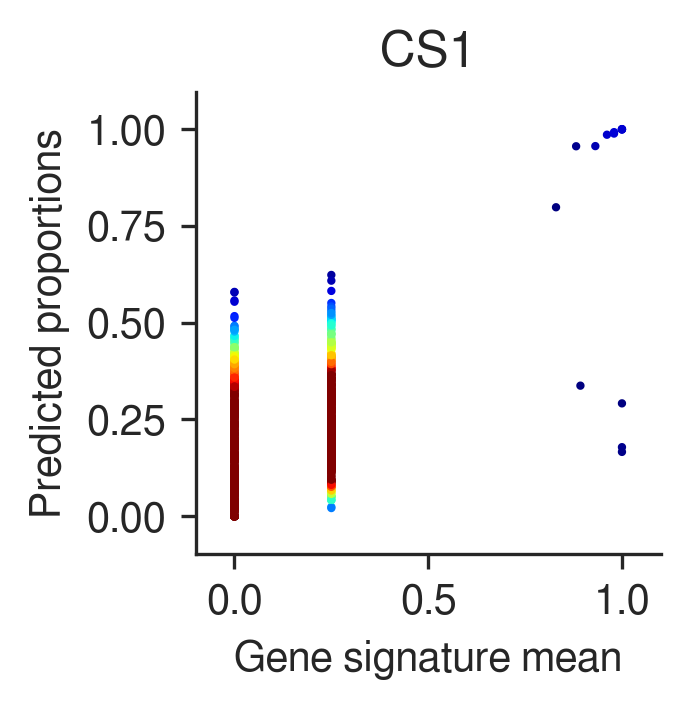

In [15]:
n_cell_types = gene_sig.shape[1]
idx = np.random.randint(0, n_cell_types)
post_analysis.gene_mean_vs_inferred_prop(inference_outputs,
                                         visium_args,
                                         idx=idx
                                        )

In [16]:
def extract_feature(adata, key):
    """
    Extract generative / inference output from adata.obsm
    generate dummy tmp. adata for plotting
    """
    assert key in adata.obsm.keys(), "Unfounded Starfysh generative / inference output: {}".format(key)

    if key == 'qc_m':
        cols = adata.uns['cell_types']  # cell type deconvolution
    elif key == 'qz_m':
        cols = ['z'+str(i) for i in range(adata.obsm[key].shape[1])]  # inferred qz (low-dim manifold)
    elif '_inferred_exprs' in key:
        cols = adata.var_names  # inferred cell-type specific expressions
    else:
        cols = ['density']
    adata_dummy = adata.copy()
    adata_dummy.obs = pd.DataFrame(adata.obsm[key], index=adata.obs.index, columns=cols)
    return adata_dummy




def pl_spatial_inf_feature(
    adata,
    feature,
    factor=None,
    vmin=0,
    vmax=None,
    spot_size=100,
    alpha=0,
    cmap='Spectral_r'
):
    """Spatial visualization of Starfysh inference features"""
    if isinstance(factor, str):
        assert factor in adata.uns['cell_types'], \
            "Invalid Starfysh inference factor (cell type): ".format(factor)
    elif isinstance(factor, list):
        for f in factor:
            assert f in adata.uns['cell_types'], \
                "Invalid Starfysh inference factor (cell type): ".format(f)
    else:
        factor = adata.uns['cell_types']  # if None, display for all cell types

    adata_pl = extract_feature(adata, feature)

    if feature == 'qc_m':
        if isinstance(factor, list):
            title = [f for f in factor]
        else:
            title = factor
        sc.pl.spatial(
            adata_pl,
            color=factor, spot_size=spot_size, color_map=cmap,
            ncols=4, vmin=vmin, vmax=vmax, alpha_img=alpha,
            title=title, legend_fontsize=8,
            save="figure_spatial_clusters.pdf"
        )
    elif feature == 'ql_m':
        title = 'Estimated tissue density'
        sc.pl.spatial(  
            adata_pl,   
            color='density', spot_size=spot_size, color_map=cmap,
            vmin=vmin, vmax=vmax, alpha_img=alpha,
            save="figure_estimated_tissue_density.pdf",
            title=title, legend_fontsize=8
        )
    elif feature == 'qz_m':
        # Visualize deconvolution on UMAP of inferred Z-space
        qz_u = get_z_umap(adata_pl.obs.values)
        qc_df = extract_feature(adata, 'qc_m').obs
        if isinstance(factor, list):
            for cell_type in factor:
                title = cell_type + ' (Inferred proportion - UMAP of Z)'
                pl_umap_feature(qz_u, qc_df[cell_type].values, cmap, title,
                                vmin=vmin, vmax=vmax)
        else:
            title = factor + ' (Inferred proportion - UMAP of Z)'
            pl_umap_feature(qz_u, qc_df[factor].values, cmap, title,
                            vmin=vmin, vmax=vmax)
    else:
        raise ValueError('Invalid Starfysh inference results `{}`, please choose from `qc_m`, `qz_m` & `ql_m`'.format(feature))

    pass


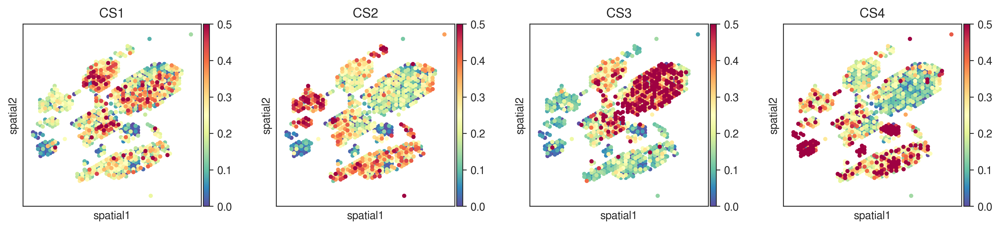

In [18]:
import scanpy as sc

pl_spatial_inf_feature(adata,
                       feature='qc_m',
                       # To display for specific cell types:
                       # factor = cell type or factor = [cell type1, ...
                       vmax=0.5)

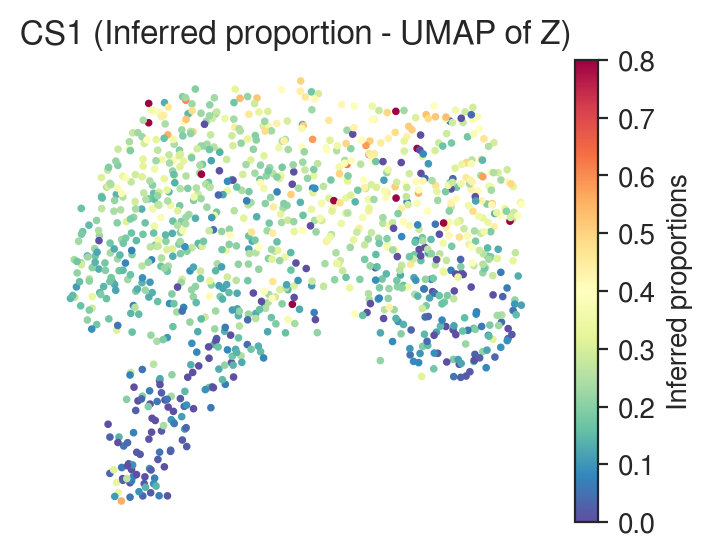

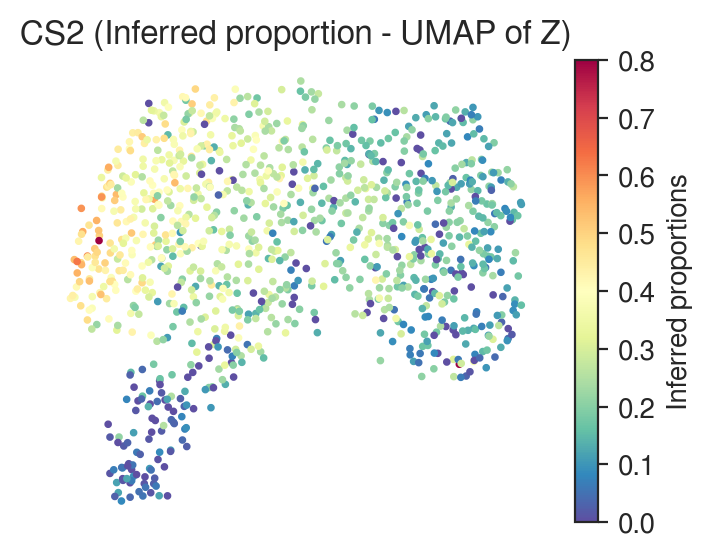

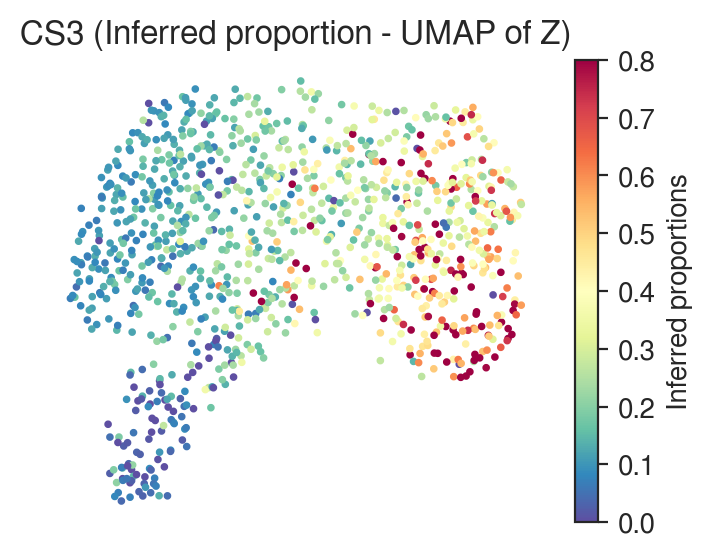

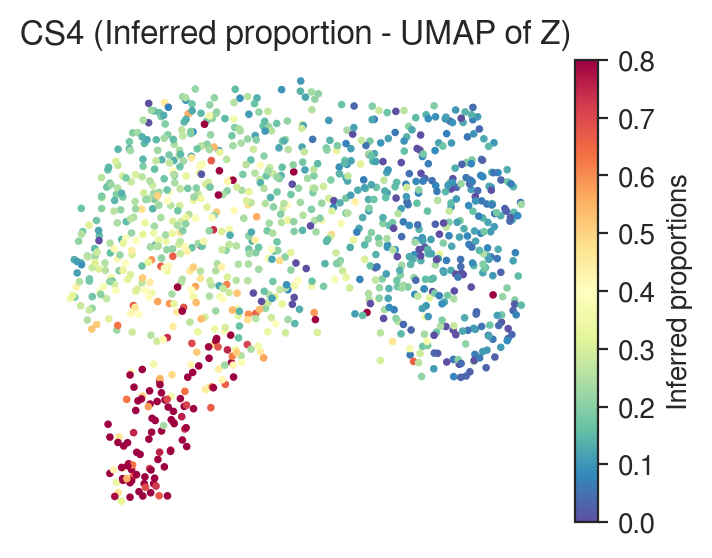

In [22]:
plot_utils.pl_spatial_inf_feature(adata,
                                  feature='qz_m',
                                  # To display for specific cell types:
                                  # factor = Cell type or factor = [Cell type1, ...]
                                  factor=['CS1', 'CS2', 'CS3', 'CS4'],
                                  spot_size=3,
                                  vmax=0.8)

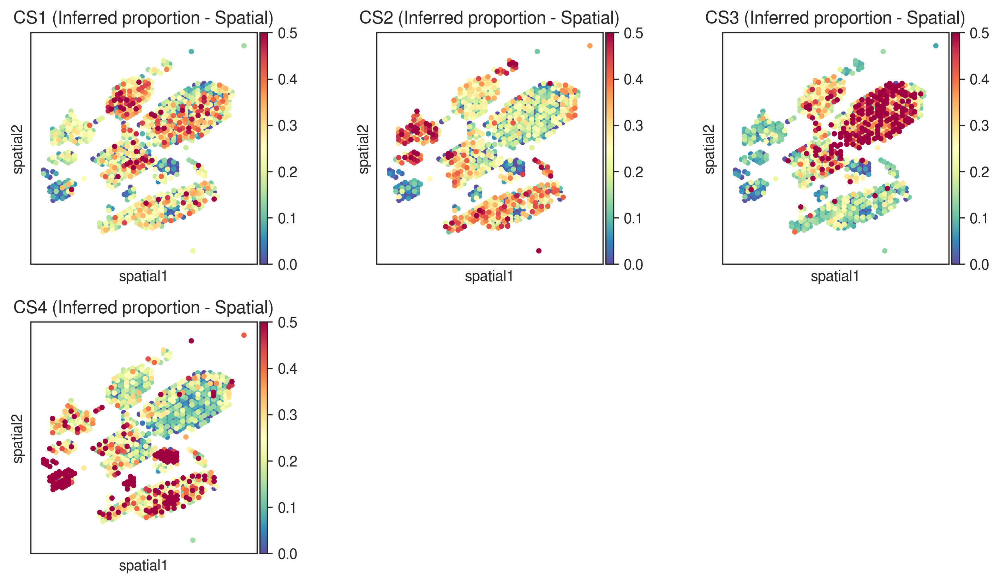

In [23]:
plot_utils.pl_spatial_inf_feature(adata,
                                  feature='qc_m',
                                  # To display for specific cell types:
                                  # factor = cell type or factor = [cell type1, ...]
                                  vmax=0.5)

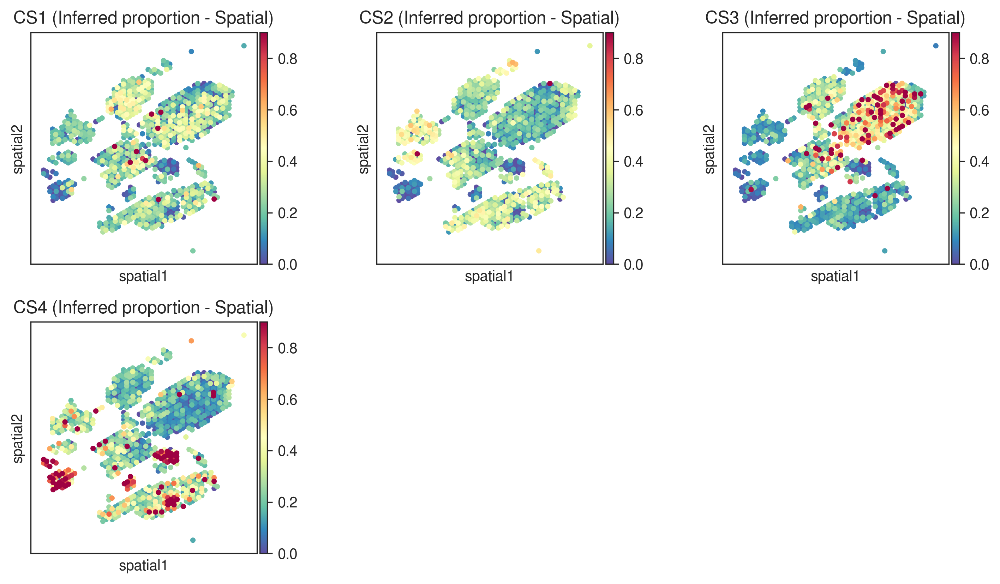

In [21]:
 plot_utils.pl_spatial_inf_feature(adata,
                                  feature='qc_m',
                                  factor=['CS1', 'CS2', 'CS3', 'CS4'],
                                  # To display for specific cell types:
                                  # factor = cell type or factor = [cell type1, ...]
                                  vmax=0.5)

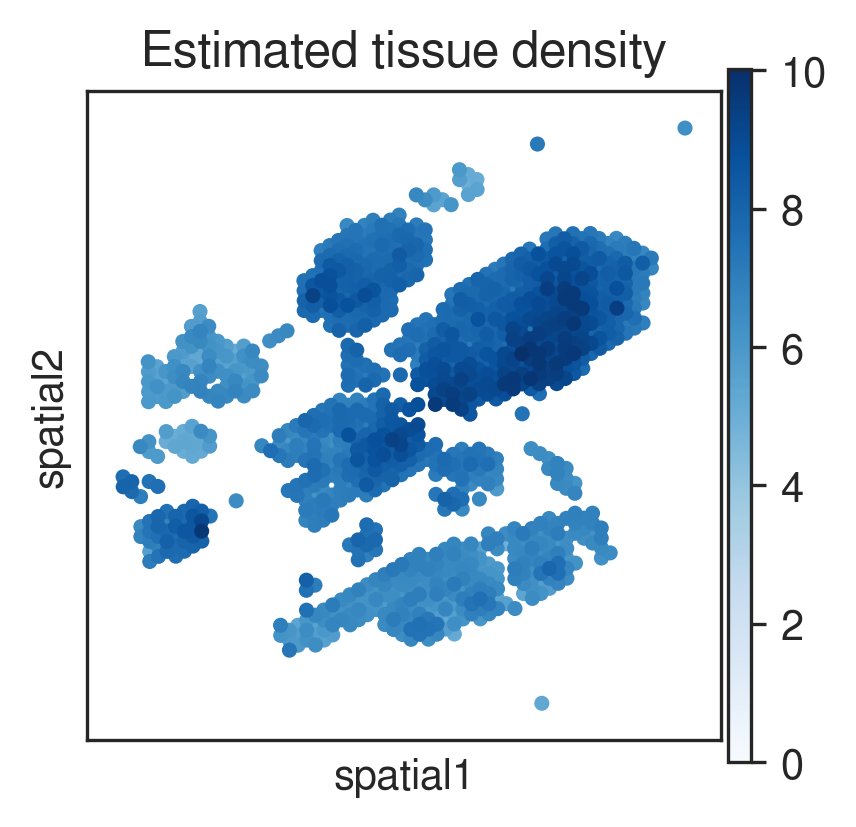

In [24]:
plot_utils.pl_spatial_inf_feature(adata, feature='ql_m', cmap='Blues')

In [19]:
data_path = 'GSM6176213_p2/'
sample_id = 'GSM6176213_p2'
sig_name = 'PCNSL_clusters.csv'

In [20]:
adata, adata_normed = utils.load_adata(data_folder=data_path,
                                       sample_id=sample_id, # sample id
                                       n_genes=5000  # number of highly variable genes to keep
                                       )

[2023-10-12 15:33:30] Preprocessing1: delete the mt and rp
[2023-10-12 15:33:31] Preprocessing2: Normalize
[2023-10-12 15:33:31] Preprocessing3: Logarithm
[2023-10-12 15:33:31] Preprocessing4: Find the variable genes


... storing 'sample' as categorical
... storing 'feature_types' as categorical
... storing 'genome' as categorical


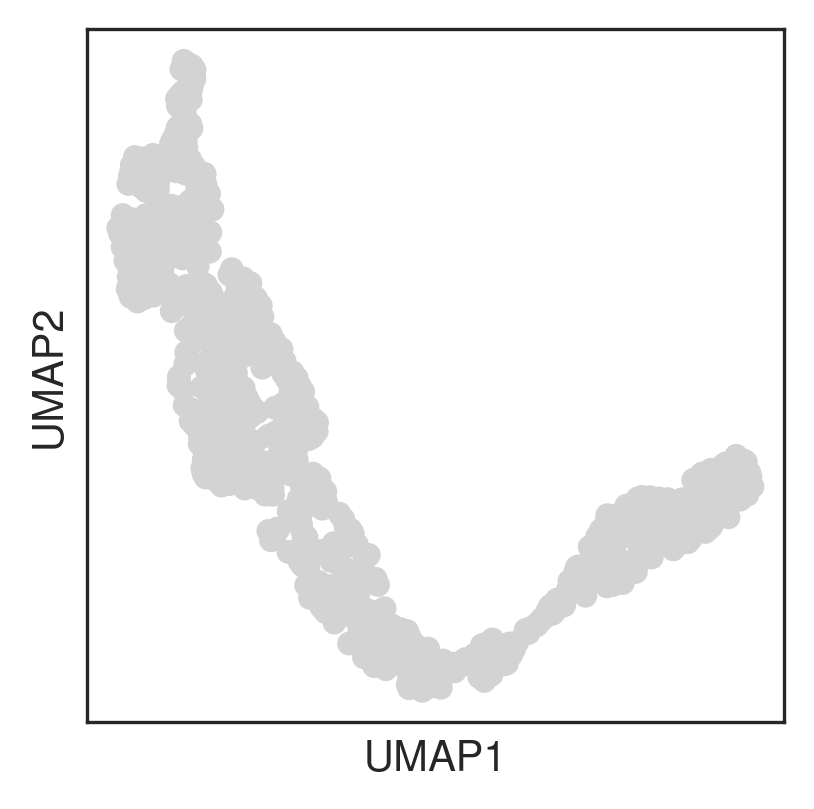

In [21]:
img_metadata = utils.preprocess_img(data_path,
                                    sample_id,
                                    adata_index=adata.obs.index,
                                    hchannel=False
                                    )
img, map_info, scalefactor = img_metadata['img'], img_metadata['map_info'], img_metadata['scalefactor']
umap_df = utils.get_umap(adata, display=True)

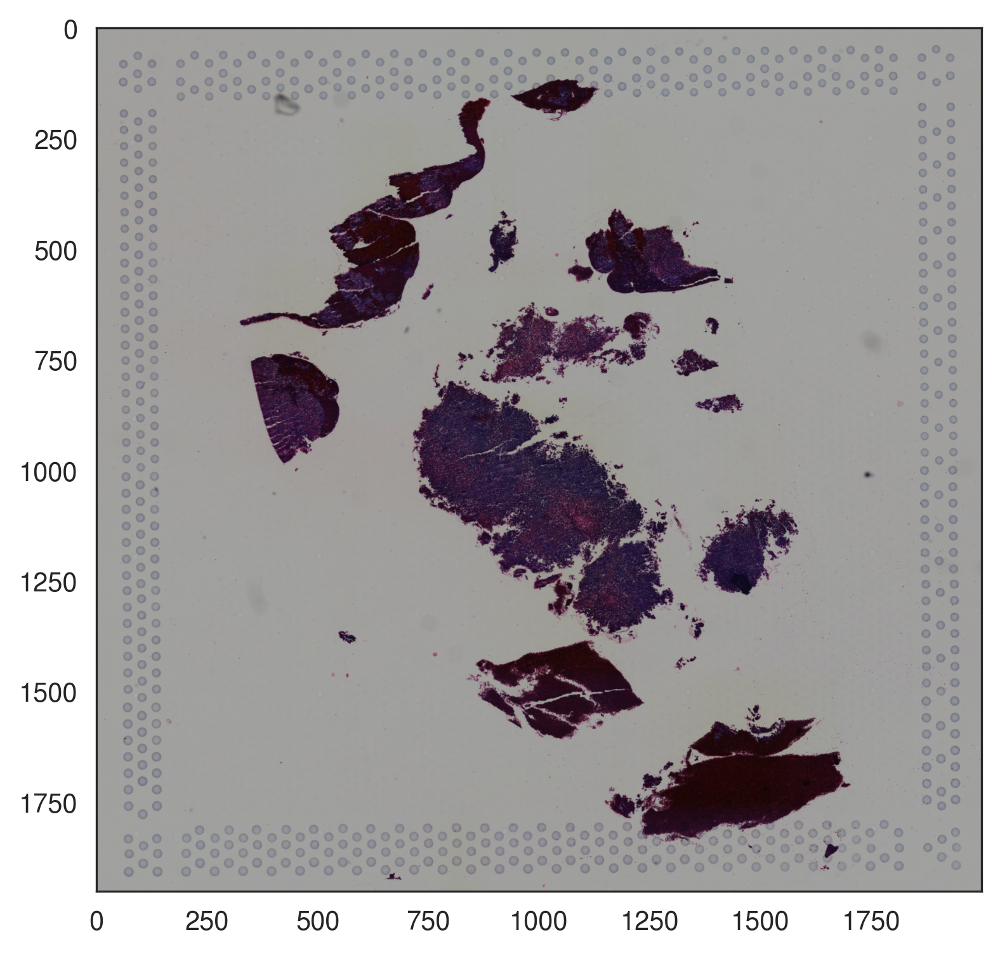

In [22]:
plt.figure(figsize=(6, 6), dpi=300)
plt.imshow(img)
plt.savefig("figures/fig_HE_visium.pdf",dpi=300,bbox_inches="tight")
plt.show()

In [23]:
# Parameters for training
visium_args = utils.VisiumArguments(adata,
                                    adata_normed,
                                    gene_sig,
                                    img_metadata,
                                    sample_id=sample_id
                                   )

adata, adata_normed = visium_args.get_adata()
anchors_df = visium_args.get_anchors()

[2023-10-12 15:33:45] Subsetting highly variable & signature genes ...
[2023-10-12 15:33:51] Smoothing library size by taking averaging with neighbor spots...
[2023-10-12 15:33:52] Retrieving & normalizing signature gene expressions...
[2023-10-12 15:33:52] Identifying anchor spots (highly expression of specific cell-type signatures)...


In [24]:
n_repeats = 3
epochs = 200
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')

In [25]:
model, loss = utils.run_starfysh(visium_args,
                                 n_repeats=n_repeats,
                                 epochs=epochs,
                                 # poe=True,
                                 device=device)

[2023-10-12 15:33:59] Running Starfysh with 3 restarts, choose the model with best parameters...
[2023-10-12 15:33:59]  ===  Restart Starfysh 1 === 

[2023-10-12 15:33:59] Initializing model parameters...
[2023-10-12 15:34:06] Epoch[10/200], train_loss: 5851.4610, train_reconst: 5744.2664, train_u: 3.1439,train_z: 19.2392,train_c: 84.5953,train_n: 3.3601
[2023-10-12 15:34:13] Epoch[20/200], train_loss: 5154.3100, train_reconst: 5077.0175, train_u: 3.5961,train_z: 22.6830,train_c: 49.3783,train_n: 5.2312
[2023-10-12 15:34:20] Epoch[30/200], train_loss: 4968.9625, train_reconst: 4892.5239, train_u: 4.1903,train_z: 24.2385,train_c: 45.9426,train_n: 6.2574
[2023-10-12 15:34:28] Epoch[40/200], train_loss: 4922.7539, train_reconst: 4846.0612, train_u: 4.8594,train_z: 25.4781,train_c: 44.5090,train_n: 6.7057
[2023-10-12 15:34:35] Epoch[50/200], train_loss: 4844.2580, train_reconst: 4771.0584, train_u: 5.5186,train_z: 24.6232,train_c: 41.4381,train_n: 7.1382
[2023-10-12 15:34:42] Epoch[60/200]

In [26]:
adata, adata_normed = visium_args.get_adata()
inference_outputs, generative_outputs = sf_model.model_eval(model,
                                                            adata,
                                                            visium_args,
                                                            # poe=True,
                                                            device=device)

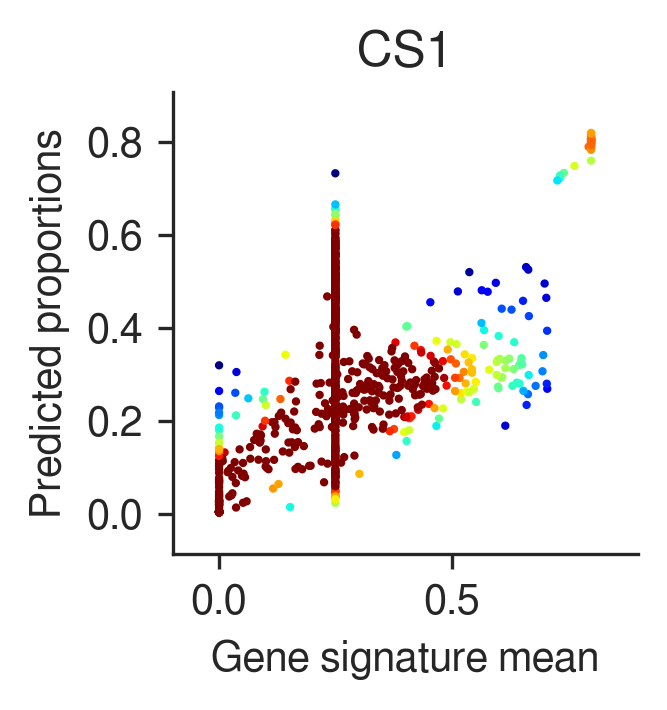

In [27]:
n_cell_types = gene_sig.shape[1]
idx = np.random.randint(0, n_cell_types)
post_analysis.gene_mean_vs_inferred_prop(inference_outputs,
                                         visium_args,
                                         idx=idx
                                        )

In [28]:
adata

AnnData object with n_obs × n_vars = 917 × 5000
    obs: 'in_tissue', 'array_row', 'array_col', 'sample', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_50_genes', 'pct_counts_in_top_100_genes', 'pct_counts_in_top_200_genes', 'pct_counts_in_top_500_genes', 'total_counts_mt', 'log1p_total_counts_mt', 'pct_counts_mt'
    var: 'gene_ids', 'feature_types', 'genome', 'highly_variable'
    uns: 'spatial', 'pca', 'neighbors', 'umap', 'cell_types', 'qu_m', 'qu_logv', 'qu', 'qs_logm'
    obsm: 'spatial', 'X_pca', 'X_umap', 'px', 'qc_m', 'qc', 'qz_m', 'qz_m_ct', 'qz_logv', 'qz_logv_ct', 'qz', 'ql_m', 'ql_logv', 'ql', 'px_rate', 'pc_p', 'xs_k'
    varm: 'PCs', 'px_r'
    obsp: 'distances', 'connectivities'

In [16]:
import scanpy as sc

In [46]:
def extract_feature(adata, key):
    """
    Extract generative / inference output from adata.obsm
    generate dummy tmp. adata for plotting
    """
    assert key in adata.obsm.keys(), "Unfounded Starfysh generative / inference output: {}".format(key)

    if key == 'qc_m':
        cols = adata.uns['cell_types']  # cell type deconvolution
    elif key == 'qz_m':
        cols = ['z'+str(i) for i in range(adata.obsm[key].shape[1])]  # inferred qz (low-dim manifold)
    elif '_inferred_exprs' in key:
        cols = adata.var_names  # inferred cell-type specific expressions
    else:
        cols = ['density']
    adata_dummy = adata.copy()
    adata_dummy.obs = pd.DataFrame(adata.obsm[key], index=adata.obs.index, columns=cols)
    return adata_dummy




def pl_spatial_inf_feature(
    adata,
    feature,
    factor=None,
    vmin=0,
    vmax=None,
    spot_size=100,
    alpha=0,
    cmap='Spectral_r'
):
    """Spatial visualization of Starfysh inference features"""
    if isinstance(factor, str):
        assert factor in adata.uns['cell_types'], \
            "Invalid Starfysh inference factor (cell type): ".format(factor)
    elif isinstance(factor, list):
        for f in factor:
            assert f in adata.uns['cell_types'], \
                "Invalid Starfysh inference factor (cell type): ".format(f)
    else:
        factor = adata.uns['cell_types']  # if None, display for all cell types

    adata_pl = extract_feature(adata, feature)

    if feature == 'qc_m':
        if isinstance(factor, list):
            title = [f for f in factor]
        else:
            title = factor
        sc.pl.spatial(
            adata_pl,
            color=factor, spot_size=spot_size, color_map=cmap,
            ncols=4, vmin=vmin, vmax=vmax, alpha_img=alpha,
            title=title, legend_fontsize=8,
            save="figure_spatial_clusters.pdf"
        )
    elif feature == 'ql_m':
        title = 'Estimated tissue density'
        sc.pl.spatial(  
            adata_pl,   
            color='density', spot_size=spot_size, color_map=cmap,
            vmin=vmin, vmax=vmax, alpha_img=alpha,
            save="figure_estimated_tissue_density.pdf",
            title=title, legend_fontsize=8
        )
    elif feature == 'qz_m':
        # Visualize deconvolution on UMAP of inferred Z-space
        qz_u = get_z_umap(adata_pl.obs.values)
        qc_df = extract_feature(adata, 'qc_m').obs
        if isinstance(factor, list):
            for cell_type in factor:
                title = cell_type + ' (Inferred proportion - UMAP of Z)'
                pl_umap_feature(qz_u, qc_df[cell_type].values, cmap, title,
                                vmin=vmin, vmax=vmax)
        else:
            title = factor + ' (Inferred proportion - UMAP of Z)'
            pl_umap_feature(qz_u, qc_df[factor].values, cmap, title,
                            vmin=vmin, vmax=vmax)
    else:
        raise ValueError('Invalid Starfysh inference results `{}`, please choose from `qc_m`, `qz_m` & `ql_m`'.format(feature))

    pass


In [25]:
sc.pp.calculate_qc_metrics(adata, inplace=True)

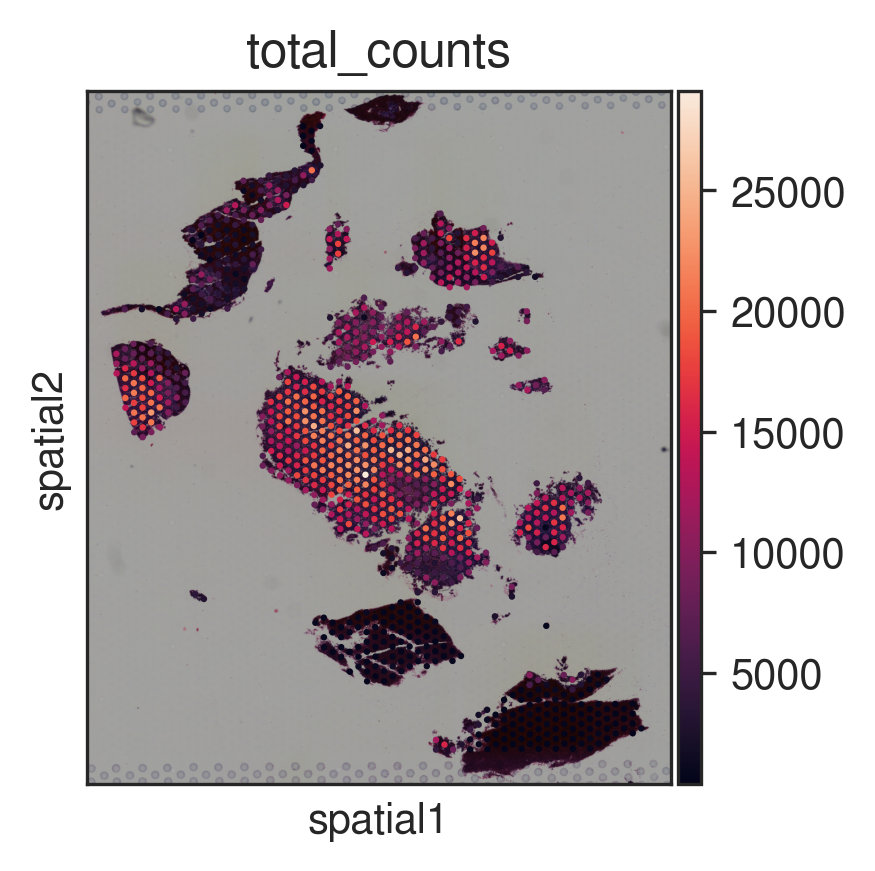

In [35]:
sc.pl.spatial(
    adata, 
    color = "total_counts",
    img_key= 'hires',
    title = "total_counts",
    save = "figure_total_counts.pdf")

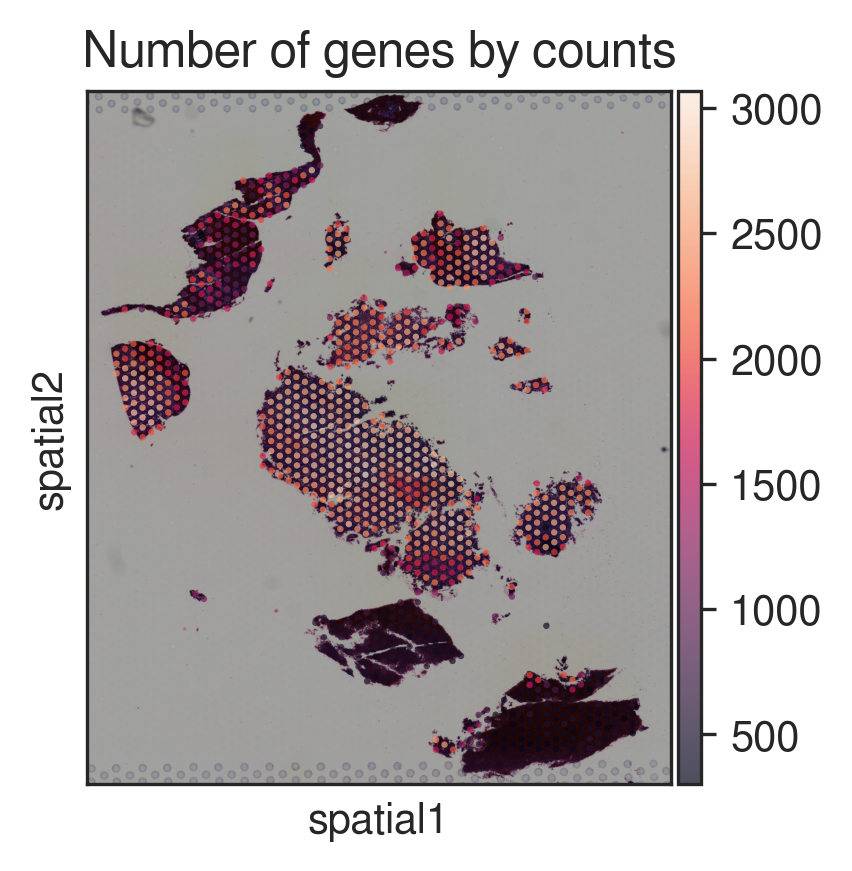

In [40]:
sc.pl.spatial(
    adata, 
    color = "n_genes_by_counts",
    alpha = 0.7,
    title = "Number of genes by counts",
    save = "figure_n_genes_by_counts.pdf")

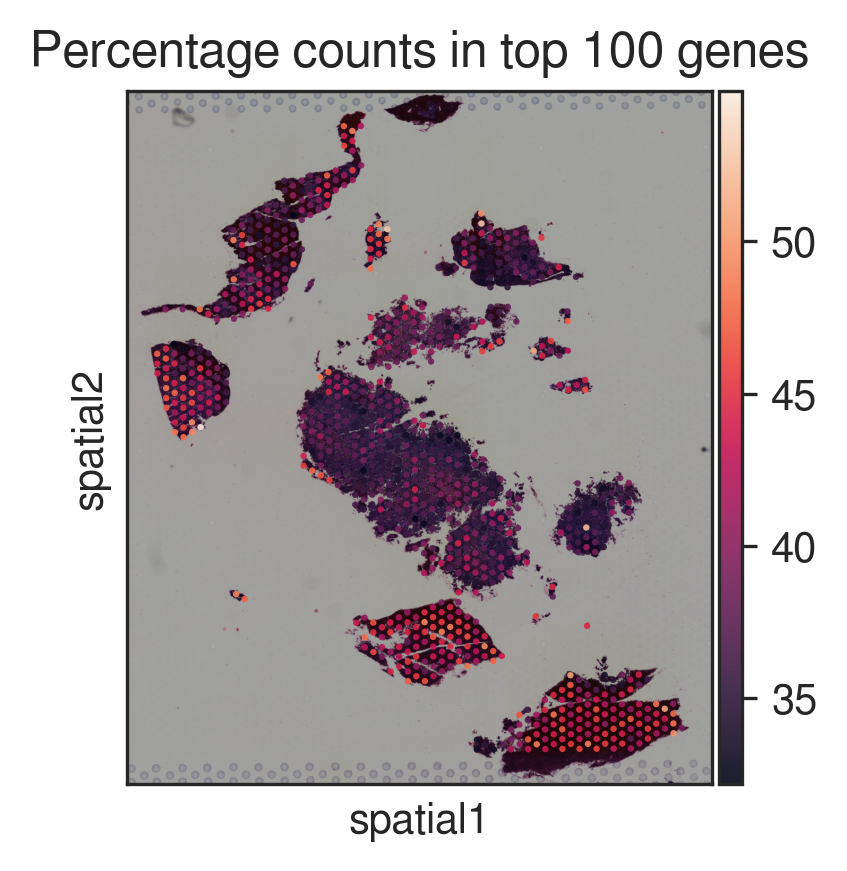

In [38]:
sc.pl.spatial(
    adata, 
    color = 'pct_counts_in_top_100_genes',
    img_key= "hires",
    alpha = 0.9,
    title = "Percentage counts in top 100 genes",
    save = "figure_ pct_counts_in_top_100_genes.pdf"
)

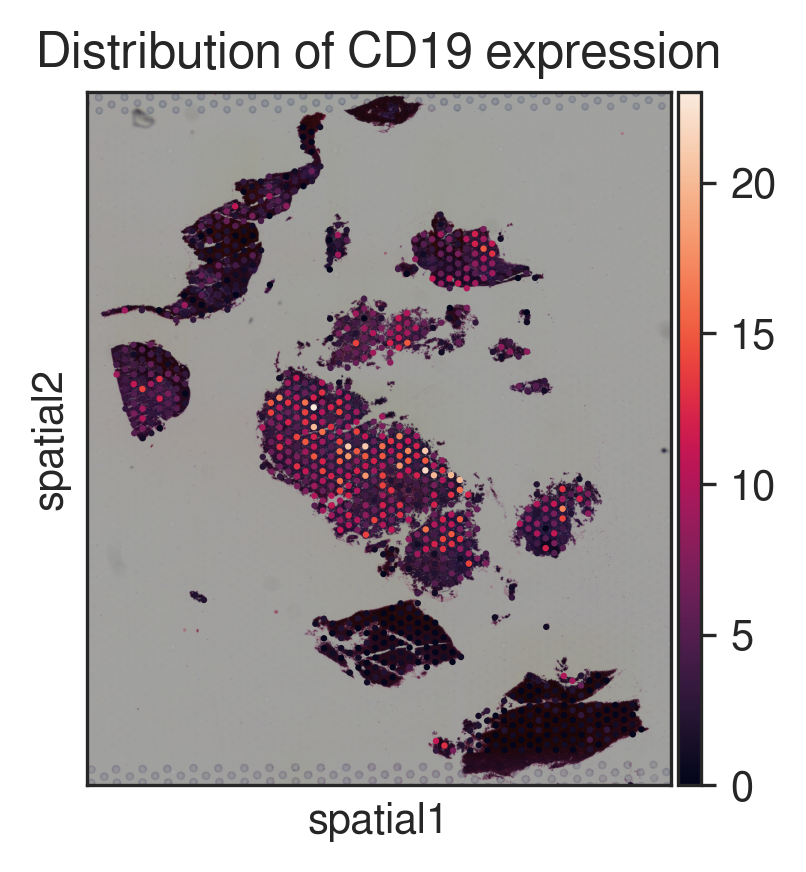

In [41]:
sc.pl.spatial(
    adata, 
    color = 'CD19',
    img_key= "hires",
    title = "Distribution of CD19 expression",
    save = "figure_ CD19_exp.pdf"
)

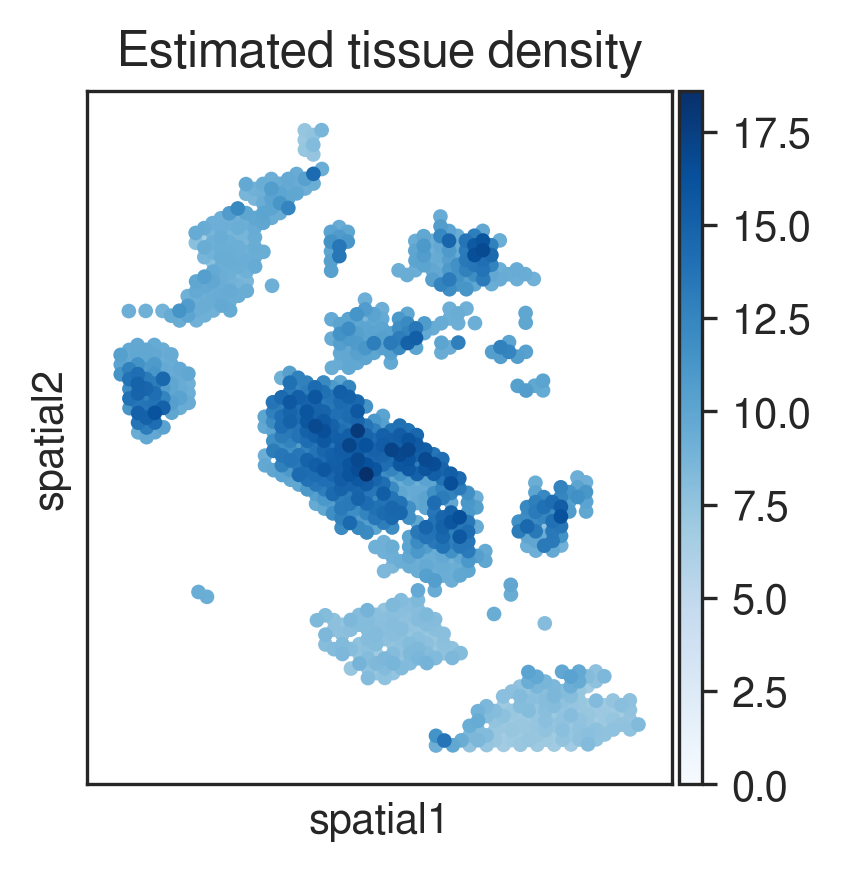

In [22]:
pl_spatial_inf_feature(adata, feature='ql_m', cmap='Blues')

In [87]:
import scanpy as sc

sc.tl.leiden(adata, key_added="clusters")

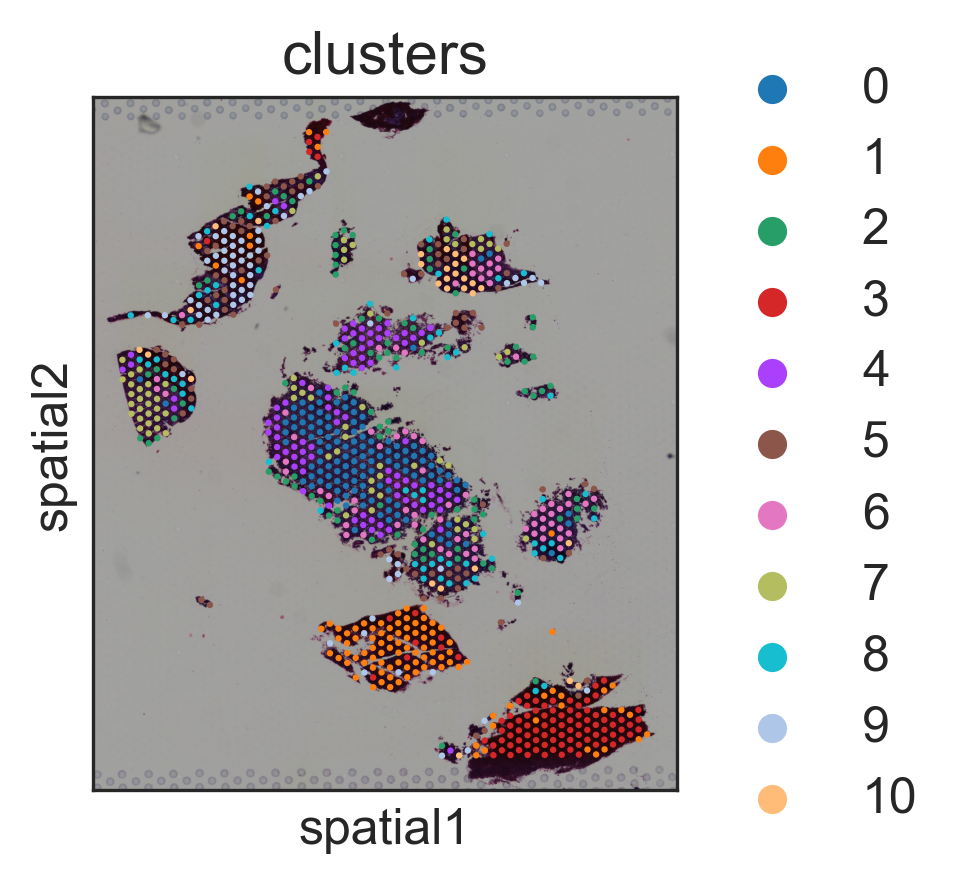

In [88]:
sc.pl.spatial(adata, color='clusters', img_key="hires")

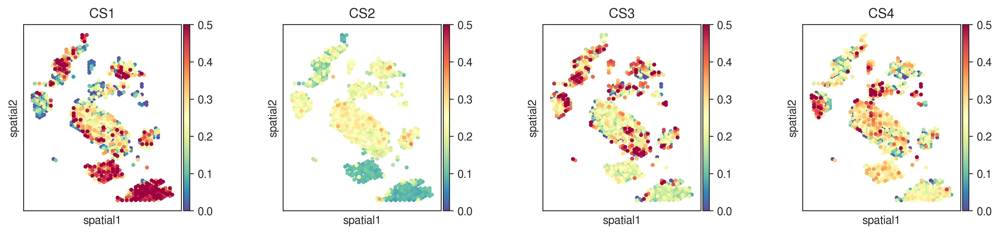

In [29]:
pl_spatial_inf_feature(adata,
                       feature='qc_m',
                       # To display for specific cell types:
                       # factor = cell type or factor = [cell type1, ...
                       vmax=0.5)

In [37]:
data_path = 'GSM6176214_p3/'
sample_id = 'GSM6176214_p3'
sig_name = 'PCNSL_clusters.csv'

In [38]:
adata, adata_normed = utils.load_adata(data_folder=data_path,
                                       sample_id=sample_id, # sample id
                                       n_genes=5000  # number of highly variable genes to keep
                                       )

[2023-10-12 15:54:46] Preprocessing1: delete the mt and rp
[2023-10-12 15:54:46] Preprocessing2: Normalize
[2023-10-12 15:54:46] Preprocessing3: Logarithm
[2023-10-12 15:54:46] Preprocessing4: Find the variable genes


... storing 'sample' as categorical
... storing 'feature_types' as categorical
... storing 'genome' as categorical


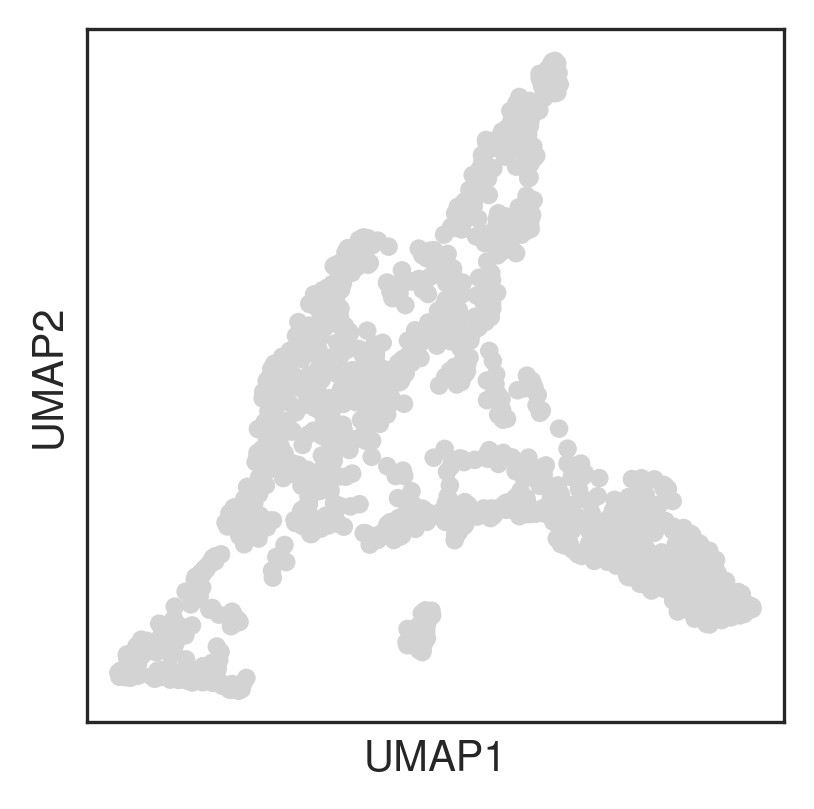

In [39]:
img_metadata = utils.preprocess_img(data_path,
                                    sample_id,
                                    adata_index=adata.obs.index,
                                    hchannel=False
                                    )
img, map_info, scalefactor = img_metadata['img'], img_metadata['map_info'], img_metadata['scalefactor']
umap_df = utils.get_umap(adata, display=True)

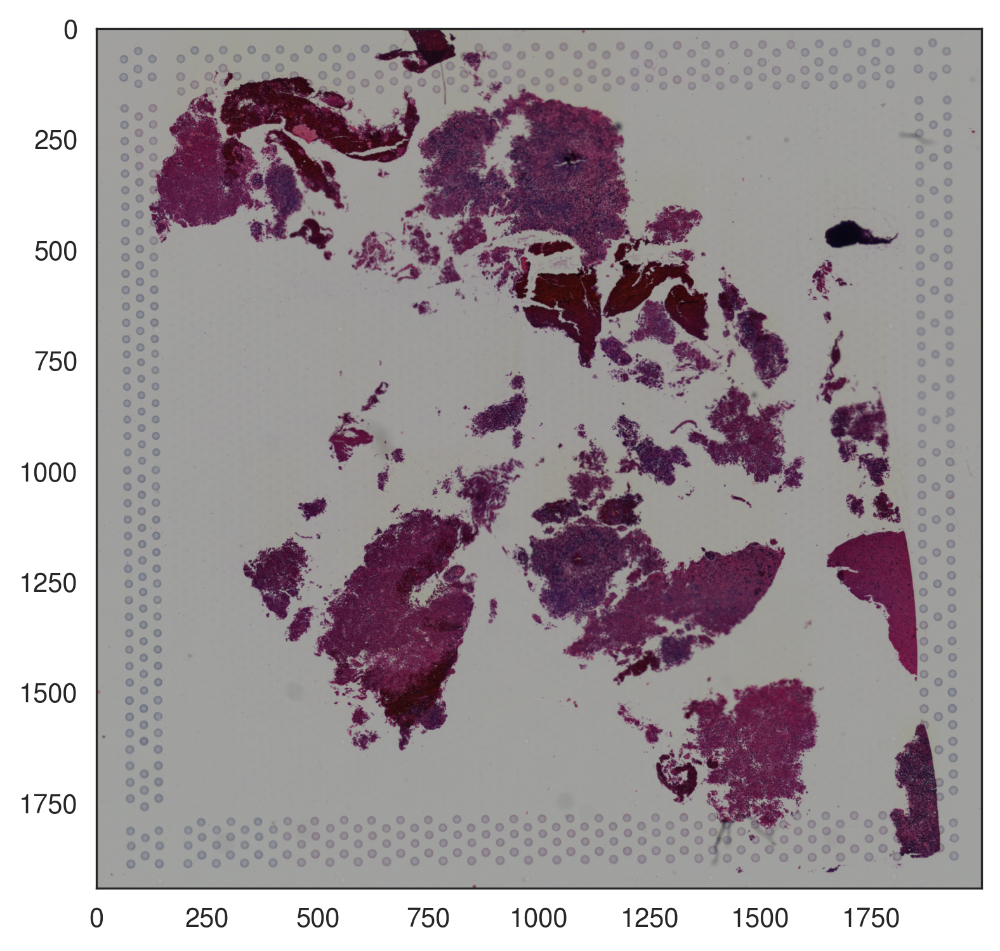

In [40]:
plt.figure(figsize=(6, 6), dpi=300)
plt.imshow(img)
plt.savefig("figures/fig_HE_visium_3.pdf",dpi=300,bbox_inches="tight")
plt.show()

In [41]:
# Parameters for training
visium_args = utils.VisiumArguments(adata,
                                    adata_normed,
                                    gene_sig,
                                    img_metadata,
                                    sample_id=sample_id
                                   )

adata, adata_normed = visium_args.get_adata()
anchors_df = visium_args.get_anchors()

[2023-10-12 15:56:18] Subsetting highly variable & signature genes ...
[2023-10-12 15:56:28] Smoothing library size by taking averaging with neighbor spots...
[2023-10-12 15:56:29] Retrieving & normalizing signature gene expressions...
[2023-10-12 15:56:29] Identifying anchor spots (highly expression of specific cell-type signatures)...


In [42]:
model, loss = utils.run_starfysh(visium_args,
                                 n_repeats=n_repeats,
                                 epochs=epochs,
                                 # poe=True,
                                 device=device)

[2023-10-12 15:57:08] Running Starfysh with 3 restarts, choose the model with best parameters...
[2023-10-12 15:57:08]  ===  Restart Starfysh 1 === 

[2023-10-12 15:57:08] Initializing model parameters...
[2023-10-12 15:57:20] Epoch[10/200], train_loss: 4315.2247, train_reconst: 4220.3312, train_u: 4.6900,train_z: 22.6788,train_c: 68.8024,train_n: 3.4123
[2023-10-12 15:57:32] Epoch[20/200], train_loss: 4077.3073, train_reconst: 3990.4462, train_u: 5.8821,train_z: 24.8248,train_c: 57.2290,train_n: 4.8072
[2023-10-12 15:57:44] Epoch[30/200], train_loss: 3931.2742, train_reconst: 3852.8501, train_u: 7.2628,train_z: 25.1229,train_c: 47.9340,train_n: 5.3673
[2023-10-12 15:57:55] Epoch[40/200], train_loss: 3865.4513, train_reconst: 3795.5517, train_u: 8.4192,train_z: 24.1625,train_c: 40.0037,train_n: 5.7334
[2023-10-12 15:58:07] Epoch[50/200], train_loss: 3835.9549, train_reconst: 3780.7350, train_u: 9.4542,train_z: 24.1650,train_c: 25.1415,train_n: 5.9133
[2023-10-12 15:58:19] Epoch[60/200]

In [44]:
adata, adata_normed = visium_args.get_adata()
inference_outputs, generative_outputs = sf_model.model_eval(model,
                                                            adata,
                                                            visium_args,
                                                            # poe=True,
                                                            device=device)

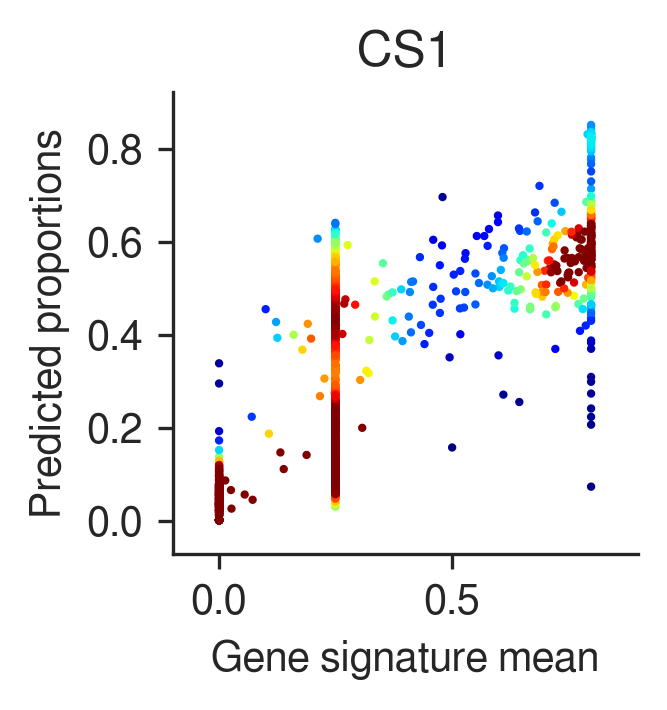

In [45]:
n_cell_types = gene_sig.shape[1]
idx = np.random.randint(0, n_cell_types)
post_analysis.gene_mean_vs_inferred_prop(inference_outputs,
                                         visium_args,
                                         idx=idx
                                        )

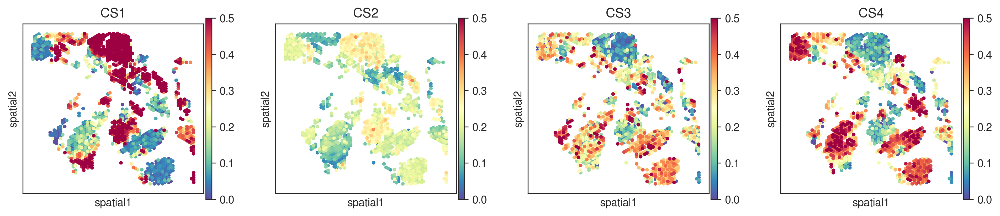

In [46]:
pl_spatial_inf_feature(adata,
                       feature='qc_m',
                       # To display for specific cell types:
                       # factor = cell type or factor = [cell type1, ...
                       vmax=0.5)

In [47]:
data_path = 'GSM6176215_p7/'
sample_id = 'GSM6176215_p7'
sig_name = 'PCNSL_clusters.csv'

In [49]:
adata, adata_normed = utils.load_adata(data_folder=data_path,
                                       sample_id=sample_id, # sample id
                                       n_genes=5000  # number of highly variable genes to keep
                                       )

[2023-10-12 21:59:55] Preprocessing1: delete the mt and rp
[2023-10-12 21:59:55] Preprocessing2: Normalize
[2023-10-12 21:59:55] Preprocessing3: Logarithm
[2023-10-12 21:59:55] Preprocessing4: Find the variable genes


... storing 'sample' as categorical
... storing 'feature_types' as categorical
... storing 'genome' as categorical


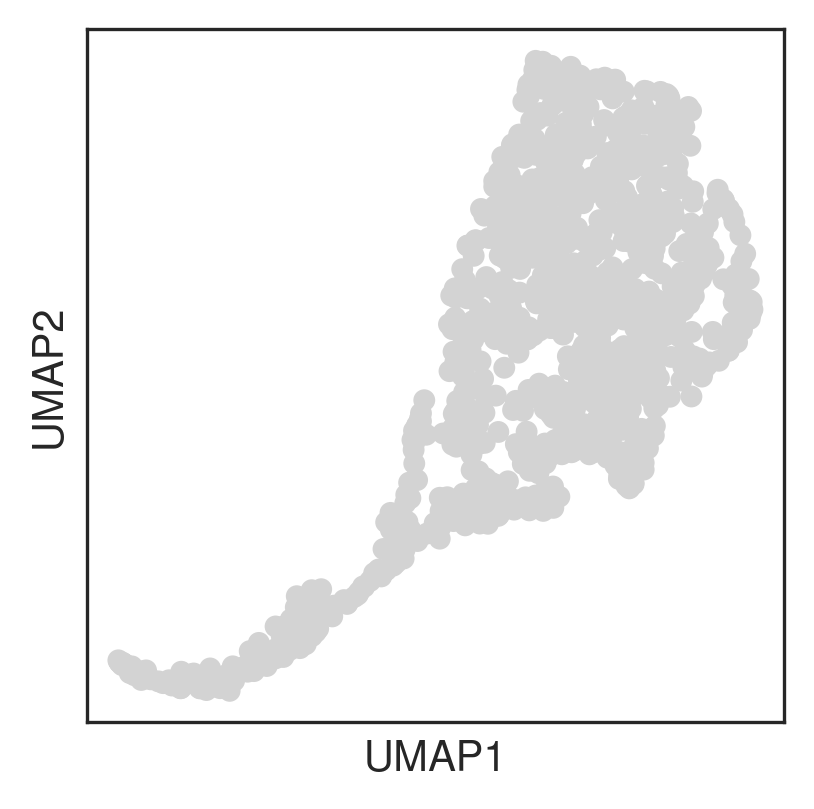

In [50]:
img_metadata = utils.preprocess_img(data_path,
                                    sample_id,
                                    adata_index=adata.obs.index,
                                    hchannel=False
                                    )
img, map_info, scalefactor = img_metadata['img'], img_metadata['map_info'], img_metadata['scalefactor']
umap_df = utils.get_umap(adata, display=True)

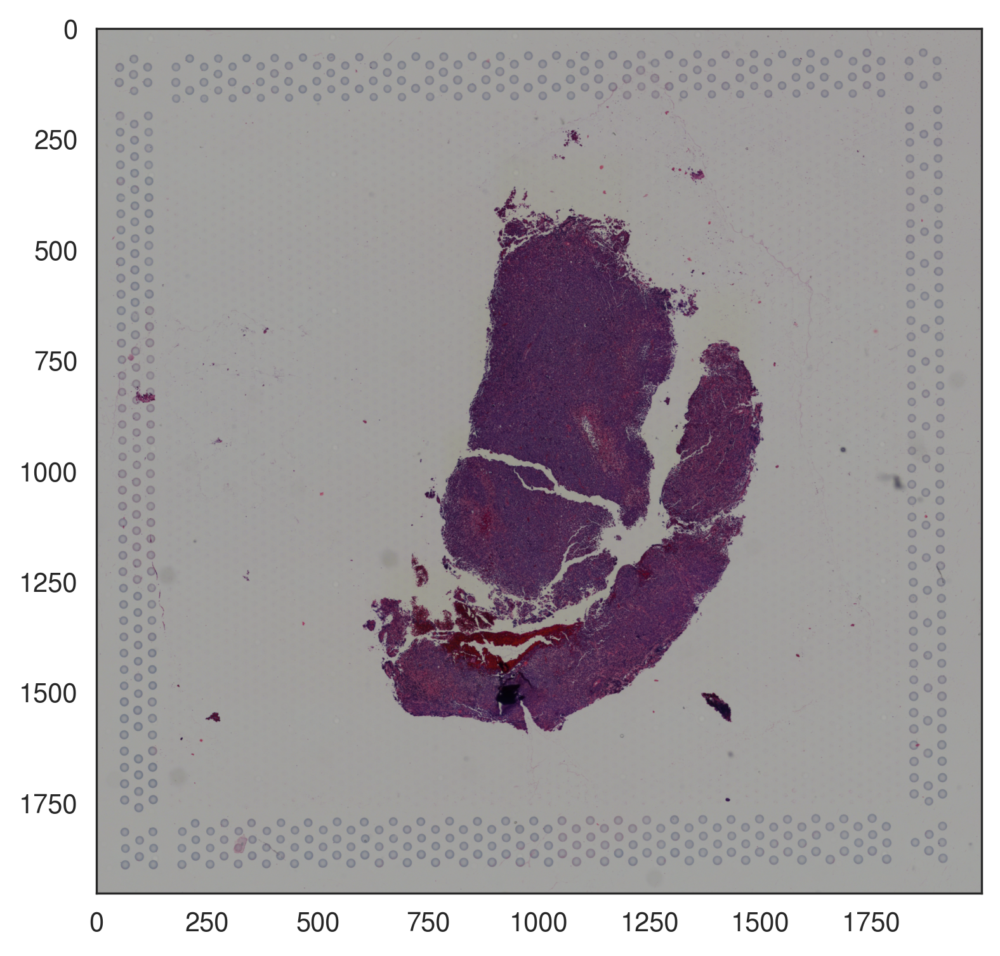

In [51]:
plt.figure(figsize=(6, 6), dpi=300)
plt.imshow(img)
plt.savefig("figures/fig_HE_visium_4.pdf",dpi=300,bbox_inches="tight")
plt.show()

In [52]:
# Parameters for training
visium_args = utils.VisiumArguments(adata,
                                    adata_normed,
                                    gene_sig,
                                    img_metadata,
                                    sample_id=sample_id
                                   )

adata, adata_normed = visium_args.get_adata()
anchors_df = visium_args.get_anchors()

[2023-10-12 22:00:33] Subsetting highly variable & signature genes ...
[2023-10-12 22:00:42] Smoothing library size by taking averaging with neighbor spots...
[2023-10-12 22:00:43] Retrieving & normalizing signature gene expressions...
[2023-10-12 22:00:43] Identifying anchor spots (highly expression of specific cell-type signatures)...


In [53]:
model, loss = utils.run_starfysh(visium_args,
                                 n_repeats=n_repeats,
                                 epochs=epochs,
                                 # poe=True,
                                 device=device)

[2023-10-12 22:01:00] Running Starfysh with 3 restarts, choose the model with best parameters...
[2023-10-12 22:01:00]  ===  Restart Starfysh 1 === 

[2023-10-12 22:01:00] Initializing model parameters...
[2023-10-12 22:01:18] Epoch[10/200], train_loss: 6401.7765, train_reconst: 6245.5007, train_u: 4.0570,train_z: 20.2003,train_c: 133.6275,train_n: 2.4481
[2023-10-12 22:01:37] Epoch[20/200], train_loss: 6047.7643, train_reconst: 5957.6347, train_u: 3.8922,train_z: 20.5698,train_c: 66.4938,train_n: 3.0660
[2023-10-12 22:01:56] Epoch[30/200], train_loss: 5751.5355, train_reconst: 5682.8397, train_u: 4.0606,train_z: 20.7305,train_c: 44.6765,train_n: 3.2888
[2023-10-12 22:02:15] Epoch[40/200], train_loss: 5633.3647, train_reconst: 5543.6248, train_u: 4.4357,train_z: 21.4524,train_c: 64.7486,train_n: 3.5389
[2023-10-12 22:02:34] Epoch[50/200], train_loss: 5562.9744, train_reconst: 5474.6897, train_u: 4.8883,train_z: 21.6695,train_c: 62.8458,train_n: 3.7694
[2023-10-12 22:02:51] Epoch[60/200

In [54]:
adata, adata_normed = visium_args.get_adata()
inference_outputs, generative_outputs = sf_model.model_eval(model,
                                                            adata,
                                                            visium_args,
                                                            # poe=True,
                                                            device=device)

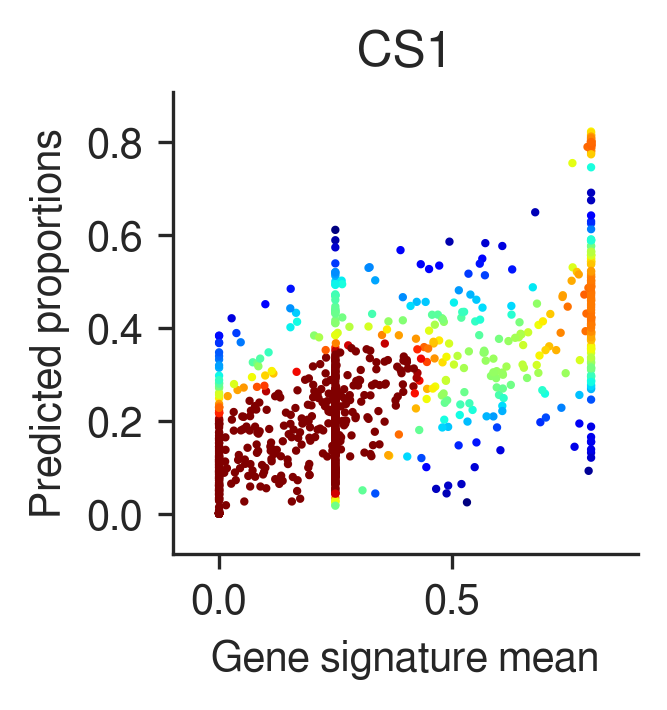

In [55]:
n_cell_types = gene_sig.shape[1]
idx = np.random.randint(0, n_cell_types)
post_analysis.gene_mean_vs_inferred_prop(inference_outputs,
                                         visium_args,
                                         idx=idx
                                        )

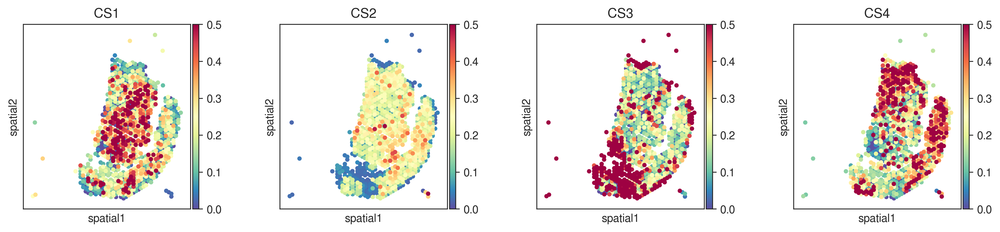

In [56]:
pl_spatial_inf_feature(adata,
                       feature='qc_m',
                       # To display for specific cell types:
                       # factor = cell type or factor = [cell type1, ...
                       vmax=0.5)